# __BPIC20 International Declarations Event Log Case Study__

__NOTE__: 
- This case study is performed with the __beta version__ of the  __DyLoPro__ library, which is developed by Brecht Wuyts in his paper '___DyLoPro: Profiling the Dynamics of Event Logs___'
- This notebook should be downloaded in order to be able to navigate efficiently by means of clicking on the internal hyperlinks. 

This notebook contains the __extensive case study on the dynamics over time in the BPIC20 International Declarations event log.__ The BPIC20 Domestic Declarations event log can be downloaded [here](https://data.4tu.nl/datasets/6a0a26d2-82d0-4018-b1cd-89afb0e8627f).  
  
This notebook consists of __5 sections__, with each section corresponding to a event log concept conceptualization, which contains the most interesting identified patterns, trends or changes over time. In each section, the visualizations are elaborated with discussions of disctinctive dynamics in markdown cells.

0. [__General Remarks and Observations__](#0-general-observations-and-remarks)
1. [__Variants__](#1-variants): The dynamics observed for the variants indicate significant and sudden changes in the control-flow perspective. 
1. [__Directly-Follows-Relations__](#2-directly-follows-relations-dfrs): The dynamics observed for the DFRs also indicate significant and sudden changes in the control-flow perspective.
1. [__Categorical Case Features__](#3-categorical-case-features): Interesting patterns and changes were observed for multiple categorical case features _(data perspective)_. 
1. [__Categorical Event Features__](#4-categorical-event-features): Interesting patterns and changes were observed for multiple categorical event features, including 'org:resource' _(resource perspective)_, 'Selected' & 'Accepted' _(both data perspective)_, and in 'concept:name', which contains the activity labels of the events _(control-flow perspective)_. 
1. [__Numerical Case Features__](#5-numerical-case-features): Only one numeric case feature is contained within the BPIC20 International Declarations event log. Apart from outliers at the beginning and the end of the dataset, no prominant changes were detected. 

The __BPIC20 International Declarations event log__ contains no numerical event features.

Importing pandas and the __DyLoPro__ library.

In [1]:
import DyLoPro as dlp
import pandas as pd

Reading in the event log and deleting the extra serial number column generated in the event log converting process.Show the first 2 rows for a glance.

In [2]:
data = pd.read_csv(r'C:\Users\Levi Tu\thesis data\InternationalDeclarations.csv')
Inter_log = data.drop(data.columns[0],axis = 1)
Inter_log.head(2)

,id,org:resource,concept:name,time:timestamp,org:role,case:Permit travel permit number,case:DeclarationNumber,case:Amount,case:RequestedAmount,case:Permit TaskNumber,...,case:concept:name,case:Permit OrganizationalEntity,case:travel permit number,case:Permit RequestedBudget,case:id,case:Permit ID,case:Permit id,case:BudgetNumber,case:Permit ActivityNumber,case:AdjustedAmount
0,rv_travel permit 76455_6,STAFF MEMBER,Start trip,2016-10-05 00:00:00+00:00,EMPLOYEE,travel permit number 76456,declaration number 76458,39.664561,39.664561,UNKNOWN,...,declaration 76457,organizational unit 65458,travel permit number 76456,41.613445,declaration 76457,travel permit 76455,travel permit 76455,budget 144133,activity 46005,39.664561
1,rv_travel permit 76455_7,STAFF MEMBER,End trip,2016-10-05 00:00:00+00:00,EMPLOYEE,travel permit number 76456,declaration number 76458,39.664561,39.664561,UNKNOWN,...,declaration 76457,organizational unit 65458,travel permit number 76456,41.613445,declaration 76457,travel permit 76455,travel permit 76455,budget 144133,activity 46005,39.664561


Converting the timestamp to required type.

In [3]:
Inter_log['time:timestamp'] = pd.to_datetime(Inter_log['time:timestamp'], format='%Y-%m-%d %H:%M:%S%z').dt.tz_convert('UTC')

Specifying the available features. The InternationalDeclarations event log contains no case outcome and no numeric event features.

In [4]:
categorical_casefeatures = ['case:Permit TaskNumber','case:Permit BudgetNumber','case:Permit ProjectNumber',
                            'case:Permit OrganizationalEntity','case:BudgetNumber','case:Permit ActivityNumber']
categorical_eventfeatures = ['org:resource', 'concept:name', 'org:role']
numeric_casefeatures = ['case:Amount','case:RequestedAmount','case:OriginalAmount','case:Permit RequestedBudget',
                        'case:AdjustedAmount']

Initializing a __DynamicLogPlots__ instance as __Inter_plots__.  
NOTE: We only want to analyze the trends for cases starting from 2016-05-10, which is the begining date of the first event in the dataset. 

In [5]:
Inter_plots = dlp.DynamicLogPlots(Inter_log,
                                  case_id_key = 'case:concept:name',
                                  activity_key = 'concept:name',
                                  timestamp_key = 'time:timestamp',
                                  categorical_casefeatures = categorical_casefeatures,
                                  categorical_eventfeatures = categorical_eventfeatures,
                                  numerical_casefeatures = numeric_casefeatures, 
                                  start_date = "10/05/2016")

Preprocessing the data...


100%|██████████| 72151/72151 [00:00<00:00, 1021471.63it/s]


All of __DyLoPro__'s plotting methods construct time series by deriving real-valued measures for a chronologically ordered set of sublogs. This chronologically ordered set of sublogs is constructed by:  
1. Defining the __frequency__ parameter, representing the frequency by which the observations are grouped. Here, for all visualizations, we use the default __frequency = 'weekly'__. In such way, the time period covered by the event log is subdivided into a chronologically ordered set of weekly time intervals.  
2. Defining the __case assignment__ parameter, representing the conditions upon which each case is assigned to one of these equal-length time intervals.Here, for all visualizations, we use the default __case assignment = 'first_event'__. In such way, each case is assigned to the time interval in which its first event occurs.

Thus, for the BPIC20 International Declarations case study with __frequency = 'weekly'__ and __case assignment = 'first_event'__, each case is assigned to the 1-week time interval in which its first event occurs and hence each sublog will consist of all cases that were initialized in one particular week.

__NOTE__: For the Inter_plots in BPIC20 International Declarations case study, we use the default settings for the following common parameters unless specified otherwise:
- time_unit = 'days'
- frequency = 'weekly'
- case_assignment = 'first_event'
- numeric_agg = 'mean'
- max_k = 10
- xtr_outlier_rem = True

## __0. General observations and remarks__:

1. Every plotting method  provides a first global overview of the amount of cases contained within each interval, and:

     
    - If __representation type = Throughput Time (TT)__ (plt_type='type_tt'): the overal throughput time aggregated over all cases contained within each time interval / sublog, (The aggregation operator is by default the mean, and can be customized by specifying the _numeric_agg_ parameter of each plotting method.)  
   
    - If __representation type = Case Length (Number of Events per Case, aka NEPC)__ (plt_type='type_events_case'): the overal case length (in NEPC) aggregated over all cases contained within each time interval / sublog. (The aggregation operator is by default the mean, and can be customized by specifying the _numeric_agg_ parameter of each plotting method.)  
   
    - If __representation type = Outcome (plt_type='type_outcome')__: the overall fraction of positive cases contained within each time interval / sublog. (No binary outcome feature is included in the BPIC20 International Declarations event log.)  

2. The default representation type of each plotting method is __Isolated__, but since each non-default representation type also includes the isolated time series, we only make use of the non-default representation types.

3. The BPIC20 International Declarations event log contains cases pertaining to two years of International travel expense claims from 2017 to 2018. Although the earliest case is recorded in the log on 2016-05-10, and the latest case ends at 2019-10-11, the majority of cases in the event log occur during 2017 and 2018. Thus, if we assume that only completed cases are extracted that roughly started after 2016-05-10 and ended before a certain extraction date, both the __beginning__ and __ending__ of the event log contain some biases:

    - __Bias__ in __beginning__ event log - By only including the cases that start after a  certain point in time, the number of ongoing cases in the beginning of the event log does not reflect the underlying actual reality. The length of period for the bias existing in the plots depends on both the chosen __frequency__, which equals to '__weekly__' in this case study, and the distribution of cases.  
    - __Bias__ in __ending__ event log - by only including the __completed__ cases that end before a certain point in time.  
        1. The number of ongoing cases towards the end of the event log does not show the underlying reality. The length of period for the bias existing in the plots depends on both the chosen __frequency__, which equals to '__weekly__' in this case study, and the __distribution__ of the throughput time of cases.  
        1. The mean throughput time (TT) of cases towards the end of the event log is lower than the underlying reality. Cases with a longer TT have a high probability to end after the extraction data and will hence be prior to be excluded from the event log. In contrast, cases with shorter TT are less likely to end before the extraction date, and will be kept in the event log. The length of period for the bias existing in the plots depends on the chosen __frequency__, which equals to '__weekly__' in this case study, and the __distribution__ of the throughput time of cases.   
        
Intervals near the beginning and ending of the event log in which the number of cases is significantly smaller compared to other time intervals, might give us non-representative samples of cases, and hence yield unrepresentative aggregations. Every plotting method also provides a first global overview of the amount of cases contained within each interval. As such, unrepresentative samples near the beginning or ending of the event log can easily be identified. Therefore, we will not report on deviating measurements if they pertain to such non-representative samples.

4. __GENERAL TRENDS__:

 - __Throughput Time (TT)__: The mean weekly TT of most cases, which gradually declines from initial 350 days in 2017-01 to remain stable fluctuation around 80 days, suddenly starts decreasing in 2018-08 and stops at the level of about 30 days around 2018-12 but rises to nearly 60 days in the end of the log. In general, the mean weekly TT fluctuates more drastically in 2017 than in 2018.
                
      - From the dynamics of cases towards the ending of event log, we can observe that the fraction cases drop significantly while the mean TT has an uprise in the end. Therefore, we can hardly judge whether there is extraction bias in the final time interval.  
       
 - __Case Length (NEPC)__: In general, the weekly mean Number of Events Per Case (NEPC) which fluctuates around 10 during the year of 2017 suddenly increases to nearly 12 around 2018-01 and keeps fluctuating on the higher level till the end of the event log. The noticeable increase of mean weekly NEPC can be correlated to the concept drift in the control-flow perspective around 2018-01.

## __1. Variants__  
We explore the dynamics over time for the top 10 most frequently occuring variants. The following interesting trends, patterns and changes are identified:  
1. Significant and sudden concept drift in the control-flow perspective around 2018-01:  
    - __Variant 3__ and __Variant 5__ supplied majority of cases originally. Around 2018-01, it suddenly declined and dropped to non-existence.
    - __Variant 1__ and __Variant 2__ rose from being non-existent to deliver most of the cases at the same time (2018-01). __Variants 4, 6, 9, 10__ also showed a similar yet less noticeable change compared to __Variant 1__ and __Variant 2__. From the plots, we can clearly see that the new variants replaced the previous variants around 2018-01.   
  
    - Comparing the activity sequences between two variants groups with contrary trends, we can infer that the main process of cases have greatly changed. In detail, the cases involving the resource 'ADMINISTRATION' suddenly emerge from being non-existent around 2018-01, accompanied with the simultaneous disappearance of cases that do not. This substitution indicates a concept drift in control-flow perspective as well as data (resource) perspective.

2. Interesting throughput time patterns for some variants:
    - From the top 10 common variants shown in the event log, the main process can be broken into two phases, namely permit process phase before trip start and declaration process phase after trip end.
    - Cases belonging to __Variant 7__ generally has a shorter mean TT than cases that do not, except some scattered cases with a high mean TT in 2017. 
    - Mean TT of Cases belonging to __Variant 8__ is higher than that of cases that do not, but the mean TT shows a declining trend in 2017, and suddenly converges to zero around 2018-01. This pattern indicates the process delivered by __variant 8__ is getting controlled in 2017, and prohibited completely in 2018.
    

Retrieving the dataframe containing the activity sequences (and counts) of the top 10 most frequently occurring variants.

In [6]:
var_df = Inter_plots.get_var_df(max_k = 10, counts = True)
print(var_df.to_string())

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                variant  variant count
variant number                                                                                                                                                                                                                                                                                                                                                                                                                                                                                        
1                         

Representation type : __Throughput Time__

Computing additional weekly Throughput Time aggregations for each of the 10 most frequently occurring variants: 100%|██████████| 10/10 [00:00<00:00, 74.92it/s]


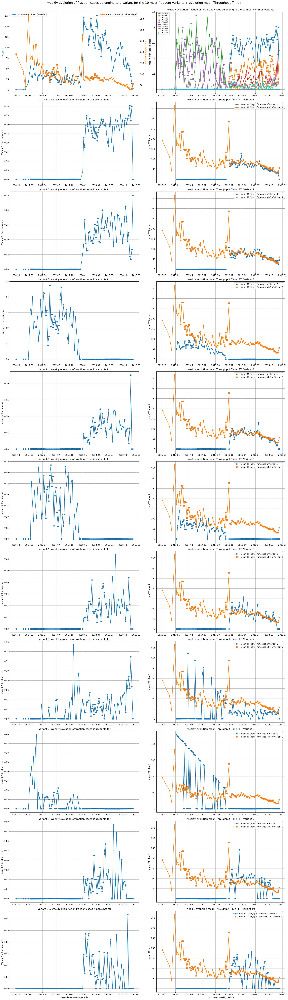

In [7]:
Inter_plots.topK_variants_evol(max_k = 10, plt_type = 'type_tt', xtr_outlier_rem = False)

## __2. Directly-Follows-Relations (DFRs)__  

We analyze the dynamics for the top 10 most frequently occurring DFRs. The following interesting trends, patterns and changes are identified:  

1. The changes in control-flow perspective identified when examining the variants are also uncovered when examing the DFR dynamics.  
    - __DFR 4, 5, 10__: Both the mean amount of occurrences per case and the fraction of cases with at least one occurrence of a certain DFR started to rise rapidly from 0 around 2018-01.    
    - Other DFR's mean amount of occurrences per case and the fraction of cases suffered a continuous fluctuation, from which we can not derive some interesting patterns, towards the ending of event log.  
  
2. __DFR 4 and DFR 5__ in general show a similar trend. 
    1. __Mean throughput time cases with at least one occurrence vs. mean throughput time all other cases__: The mean throughput time of cases containing at least one occurrence of __DFR 4 or DFR 5__ in 2017 shows an extreme trend, namely being either higher than mean TT of case that don't contain or zero. The higher mean TT additionally shows a declining trend towards 75 days. From 2018-01 to 2018-07, the mean TT of cases containing at least one occurrence of __DFR 4 or DFR 5__ fluctuates in this relatively stable level. Afterwards, the mean TT starts to decrease towards 35 days. The mean TT of cases that do not belong to __DFR 5__ only displays few scattered values after 2018-04, indicating that only few cases after 2018-04 don't have __DFR 5__ in their processes.  
    
    1. __Mean case length (NEPC) cases with at least one occurrence vs. mean NEPC all other cases__: The mean number of events per case (NEPC) of cases containing __DFR 4 or DFR 5__ experiences a sudden and notable increase around 2018-01. The mean NEPC of cases containing __DFR 4 or DFR 5__ mostly remains zero while few case  isolatedly displays a high TT peak during the year of 2017. Mean NEPC suddenly increases to nearly 12.5 around 2018-01 and keeps fluctuating on the higher level till the end of the event log. 
    1. __Mean DFR performance cases with at least one occurrence__: The mean DFR performance of DFR 1 increases from the begining to reach a high peak about 12 days at 2017-07, then starts to decline gradually to at least 2 days around 2018-04. Afterwards, the DFR performance of DFR 1 fluctuates increasingly to reach a small peak of 6 days at 2018-08, and fluctuates decreasingly towards the ending.   

3. __Mean throughput time (TT) cases with at least one occurrence vs. mean throughput time all other cases__: 
   - Cases containing __DFR 8, 9, 10__ show a gradual decline in general. The overall change consist of two phases, namely a discrete decline in 2017 from more than 350 days to nearly 90 days and a continuous decline in 2018 from fluctuating around 75 days to nearly 30 days. The 

4. __Mean case length (NEPC) cases with at least one occurrence vs. mean NEPC all other cases__:  
   - The mean number of events per case (NEPC) of cases containing __DFR 8, 9 or 10__ remains zero in most of time in 2017, except some isolated peak(s) in few weekly intervals. After 2018-01, __DFR 8 and DFR 9__ suddenly increase to fluctuate around 11, while __DFR 10__ increases more significantly to a higher level around 12.
   - The mean NEPC of cases containing __DFR 1 or DFR 2__ shows a gradual increase from 8 to 12. Since __DFR 1 and DFR 2__ are the last 2 process nodes most cases will experience, thus, we can infer that the majority of cases have extended their processes from 2017 to 2018.

5. __Mean DFR performance cases with at least one occurrence__:  
   - The mean DFR performance of __DFR 6__ shows a drastical fluctuation around 20 days in 2017, yet reaches a steady fluctuation at 10 days after 2018-01. This indicates the enhancement of cases containing __DFR 6__ since 2018-01.  
   - The __DFR 6__ (End trip - Declaration SUBMITTED by EMPLOYEE), whose performance gets improved from nearly 20 days on average to a steady fluctuation around 10 days since 2018-01, and __DFR 7__ (Permit FINAL_APPROVED by SUPERVISOR - Start trip), whose performance takes approximately 40 days, are __the most time-consuming bottlenecks in the process model.__ The two DFRs exactly locate in the period before the start and after the end of trips, which take place between the permit process phase and the declaration process phase.

Retrieving the dataframe containing the activity pairs (and counts) of the top 10 most frequently occurring DFRs.

In [8]:
dfr_df = Inter_plots.get_DFR_df(max_k = 10, counts = True)
print(dfr_df.to_string())

                                                                                           DFR  DFR count
DFR number                                                                                               
1                                                           (Request Payment, Payment Handled)       6149
2                                  (Declaration FINAL_APPROVED by SUPERVISOR, Request Payment)       5918
3                                                                       (Start trip, End trip)       5784
4                  (Declaration SUBMITTED by EMPLOYEE, Declaration APPROVED by ADMINISTRATION)       4952
5                            (Permit SUBMITTED by EMPLOYEE, Permit APPROVED by ADMINISTRATION)       4829
6                                                (End trip, Declaration SUBMITTED by EMPLOYEE)       4591
7                                            (Permit FINAL_APPROVED by SUPERVISOR, Start trip)       4206
8           (Declaration APPROVED by ADMINISTR

#### __2.1 Representation type : Throughput Time (TT)__

Computing additional weekly Throughput Time aggregations for each of the 10 most frequently occurring DFRs: 100%|██████████| 10/10 [00:00<00:00, 56.74it/s]


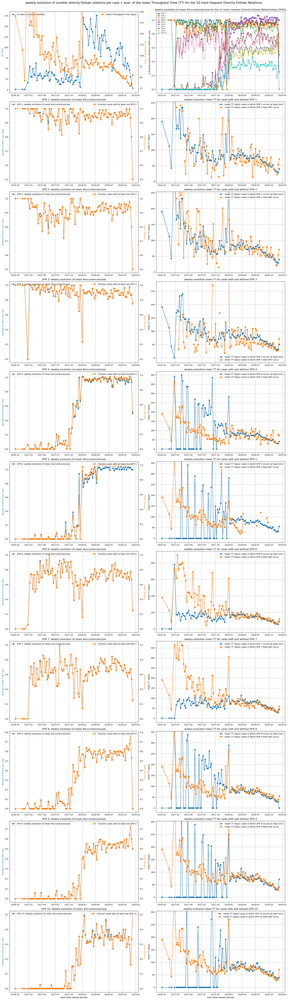

In [9]:
Inter_plots.topK_dfr_evol(plt_type = 'type_tt')

#### __2.2 Representation type : Case Length (NEPC)__

Computing additional weekly aggregations of the amount of events per case for each of the 10 most frequently occurring DFRs: 100%|██████████| 10/10 [00:00<00:00, 54.01it/s]


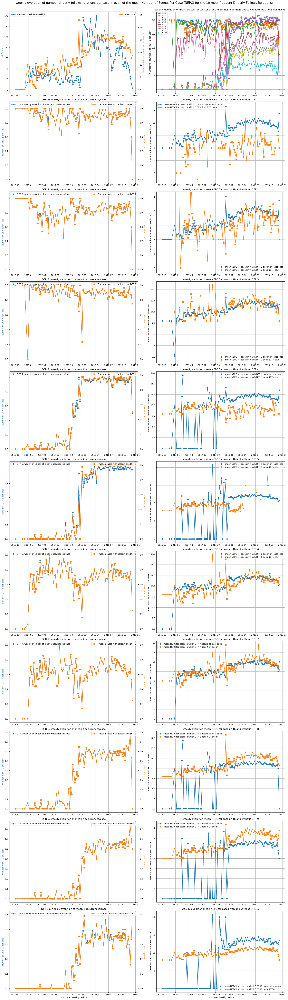

In [10]:
Inter_plots.topK_dfr_evol(plt_type = 'type_events_case')

#### __2.3 Representation type : DFR Performance__

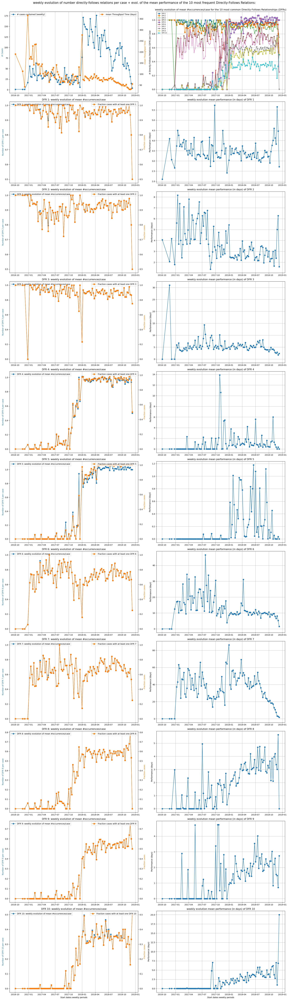

In [11]:
Inter_plots.topK_dfr_evol(plt_type = 'type_dfr_performance', xtr_outlier_rem = False)

## __3.Categorical Case Features__

For each categorical case feature, the evolutions pertaining to the most frequently occurring level are plotted first, those pertaining to the second most occurring level are plotted secondly, and so on. The categorical case features in BPIC20 International Declarations event log contain 6 features, each of which is used for unique identifications of case's attributes. The fraction of a certain case that only has an unique identification is extremely lower and ignorable compared to all cases. Hence, the plots of these categorical cases features display few interesting patterns.

In [12]:
categorical_casefeatures

['case:Permit TaskNumber',
 'case:Permit BudgetNumber',
 'case:Permit ProjectNumber',
 'case:Permit OrganizationalEntity',
 'case:BudgetNumber',
 'case:Permit ActivityNumber']

### 3.1 Categorical Case Features: 'case:Permit TaskNumber'
Categorical case feature '__case:Permit TaskNumber__' has 6 distinct levels, each of which represents a unique case permit task number. We analyze the dynamics of all 6 frequenly occurring levels of '__case:Permit TaskNumber__'. Few interesting trends, patterns and changes are identified:  

1. __Fraction of cases pertaining to each level__:   
    - Cases with a permit task number __'task 427'__ occupy a predominant fraction, namely 50%-85%, among all cases. The second majority permit task number (20%-50%) is __'UNKNOWN'__，which represents an unclear but still acceptable value for filling the permit task number. All cases pertaining to all other permit task numbers except above two only occupy less than 10%.
    - Two suddenly-dropping patterns around 2017-08 and 2018-08 are observed. These recurrent troughs might be correlated to a seasonal factor. For example, employees who take a summer vacation in August prefer not to submit their declarations during the vacation, causing the drop of cases fractions.  

2. __Mean Throughput Time (TT) cases pertaining to a certain level vs. mean TT all other cases__:
    - In general, the mean TT of __'task 427'__ fluctuates decreasingly. Mean TT of cases with a permit task number __'task 427'__ experiences a gradual decline in 2017, and rises slightly around 2018-01, then from this point of time, starts to decline gradually again. 
    - Mean TT of cases pertaining to another single case permit task number except __'task 427'__ and __'UNKNOWN'__ only shows one or several single peak(s) at the time interval when the case containing this permit task number occurs.   
    
3. __Mean Case Length (in number of events per case, aka NEPC) cases pertaining to a certain level vs. mean NEPC all other cases__:   
    - Mean NEPC of cases pertaining to __'task 427'__ and __'UNKNOWN'__ show a similar pattern, which starts to gradually rise from initial 9 to 12 since 2018-01.
    - Mean TT of cases pertaining to all other permit task number displays isolated peak(s) at the time interval when the case belonging this case permit task number occurs.  

#### __3.1.1 'case:Permit TaskNumber' - Representation type: Throughput Time (TT)__

Computing additional weekly aggregations of the Throughput Time for each of the 6 most frequently occurring levels: 100%|██████████| 6/6 [00:00<00:00, 53.22it/s]


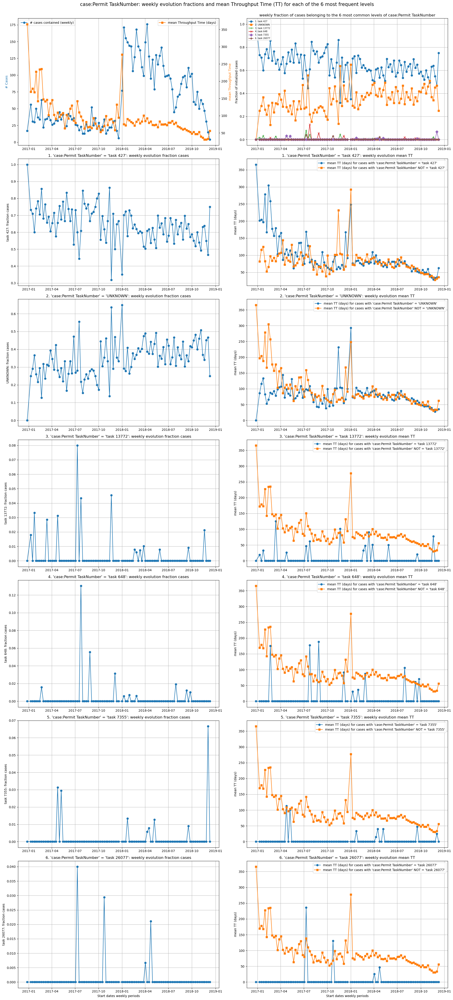

In [35]:
Inter_plots.topK_categorical_caseftr_evol(case_feature = 'case:Permit TaskNumber', plt_type = 'type_tt', xtr_outlier_rem = False)

#### __3.1.2 'case:Permit TaskNumber' - Representation type: Case Length (NEPC)__

Computing additional weekly aggregations of the Number of Events Per Case (NEPC) for each of the 6 most frequently occurring levels: 100%|██████████| 6/6 [00:00<00:00, 44.53it/s]


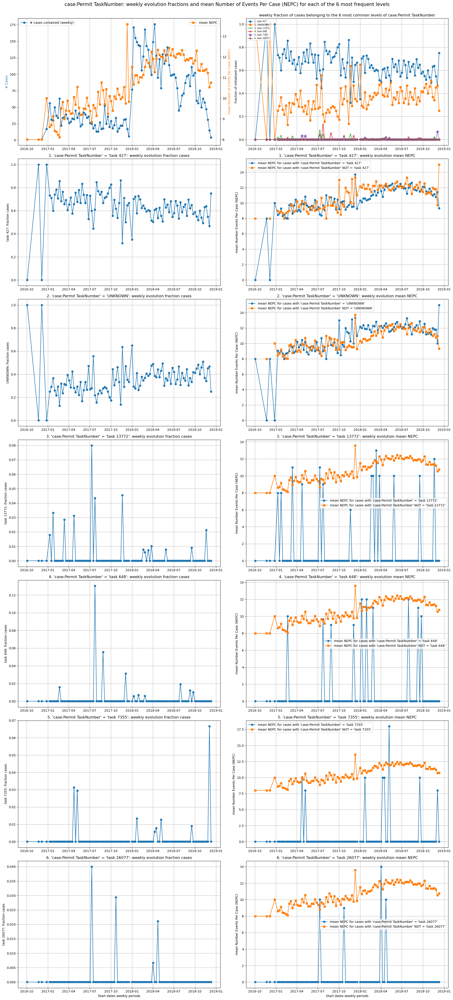

In [12]:
Inter_plots.topK_categorical_caseftr_evol(case_feature = 'case:Permit TaskNumber', plt_type = 'type_events_case', xtr_outlier_rem = False)

### __3.2 Categorical Case Features: 'case:Permit ProjectNumber'__
Categorical case feature '__case:Permit ProjectNumber__' has thousands of distinct levels, each of which represents a unique case permit project number. We analyze the dynamics of the top 10 frequenly occurring levels of '__case:Permit ProjectNumber__'. The interesting trends, patterns and changes are identified:  

1. __Fraction of cases pertaining to each level__:   
    - Cases with a permit task number  __'UNKNOWN'__ occupy a predominant fraction, namely 20%-50%, among all cases. The second majority permit task number (20%-50%) is __'project 426'__，which can be correlated with the previous permit task number __'task 427'__. All cases pertaining to all other permit project numbers except above two generally occupy less than 10%.
    
2. __Mean Throughput Time (TT) cases pertaining to a certain level vs. mean TT all other cases__:
    - In general, the mean TT of cases pertaining to __'project 426'__ has a straight linear decrease from more than 400 days in 2017-01 to 0 day around 2018-04. This unusual pattern seems interesting and needs further exploration.
    - Mean TT of cases pertaining to another single case permit project number except __'UNKNOWN'__ and __'project 426'__ only shows one or several single peak(s) at the time interval when the case containing this permit task number occurs.   
    
3. __Mean Case Length (in number of events per case, aka NEPC) cases pertaining to a certain level vs. mean NEPC all other cases__:   
    - Mean NEPC of cases pertaining to __'UNKNOWN'__ shows an increasing pattern, which starts to gradually rise from initial 9 to 12 since 2018-01.
    - Mean NEPC of cases pertaining to __'project 426'__ shows a discrete change. However, we can still clearly observe a rising trend starting at 2018-01 which increases from 6-7 to 8 or even to 12 occurred in few cases.
    - Mean TT of cases pertaining to all other permit task number displays isolated peak(s) at the time interval when the case belonging this case permit project number occurs.  

#### __3.2.1 'case:Permit ProjectNumber' - Representation type: Throughput Time (TT)__

Computing additional weekly aggregations of the Throughput Time for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 121.96it/s]


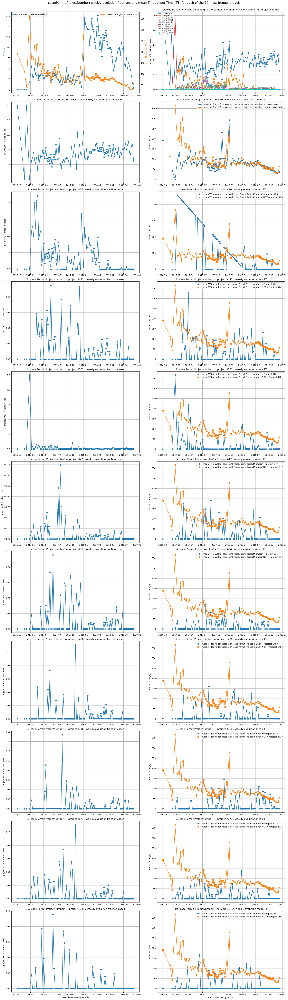

In [18]:
Inter_plots.topK_categorical_caseftr_evol(case_feature = 'case:Permit ProjectNumber', plt_type = 'type_tt', xtr_outlier_rem = False)

#### __3.2.2 'case:Permit ProjectNumber' - Representation type: Case Length (NEPC)__

Computing additional weekly aggregations of the Number of Events Per Case (NEPC) for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 115.28it/s]


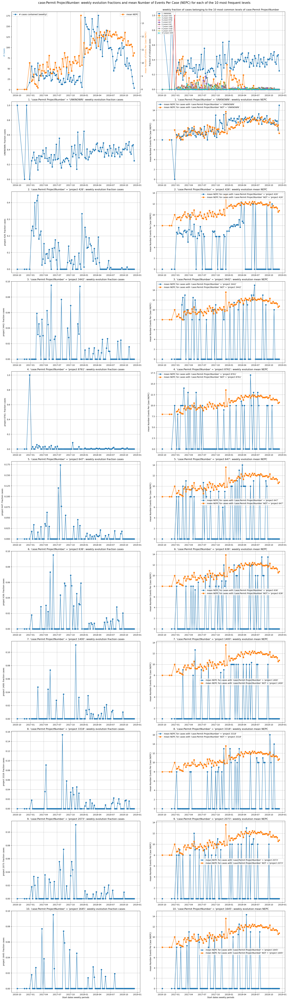

In [19]:
Inter_plots.topK_categorical_caseftr_evol(case_feature = 'case:Permit ProjectNumber', plt_type = 'type_events_case', xtr_outlier_rem = False)

## __4. Categorical Event Features__  

### __4.1 Categorical Event Feature: 'org:role'__   
### __4.1 Categorical Event Features: 'org:role'__    
__'org:role'__ refers to the column containing information about the resources that executes a certain event. The BPIC20 International Declarations event log contains 8 unique resources. In this subsection, we analyze the dynamics for all the 8 resources over time.
1. __Fraction of cases pertaining to each level__:   
    - Categorical event features 'org:role' contains 8 distinct levels of resources. Two kinds of resources, namely __'Missing'__ and __'PRE_APPROVER'__ only exist in 2017 and suddenly disappear respectively at 2017-11 and 2018-01.   
    - On the other hand, another two types of resources, namely __'ADMINISTRATION'__ and __'BUDGET OWNER'__, initially don't exist but quickly start to rise around 2017-11. This contrary trend around same time might indicate a concept drift in the resource perspective, which causes a resource substitution.  

2. __Mean Throughput Time (TT) cases pertaining to a certain level vs. mean TT all other cases__:   
    - After the emergence of __'ADMINISTRATION'__ and __'BUDGET OWNER'__ since 2018, the mean TT of overall cases becomes more stable than in 2017 when these two resources haven't emerged yet. The mean TT of __'ADMINISTRATION'__ decreases gradually from nearly 400 days in 2017-01 to fluctuates around 75 days since 2018-01.   
  
3. __Mean Case Length (in number of events per case, aka NEPC) cases pertaining to a certain level vs. mean NEPC all other cases__:  
    - Mean NEPC pertaining to __'ADMINISTRATION'__ and __'BUDGET OWNER'__ have a similar trend to the mean TT. Both don't exist originally yet emerge suddenly from 2017-11. But mean NEPC cases pertaining to __'BUDGET OWNER'__ remains around 13, which is slightly higher than mean NEPC pertaining to __'ADMINISTRATION'__ (around 12). This implies that cases containing __'BUDGET OWNER'__ usually experience one extra approval activity than cases containing __'ADMINISTRATION'__.  
    - Mean NEPC pertaining to __'EMPLOYEE'__ experiences a sudden uprise from 9-10 to 11.5-12.5 in 2018-01. Since employee executes the start activity, each case contains the __'EMPLOYEE'__ resource. Thus, we could infer that all cases have added extra activities in the process. This extension of process is ubiquitous. Similar trends can be found in cases pertaining to __'SUPERVISOR'__ or __'UNDEFINED'__.

#### __4.1.1 'org:role' - Representation type: Throughput Time (TT)__

Computing the weekly aggregations for each of the 8 most frequently occurring levels of categorical event feature 'org:role': 100%|██████████| 8/8 [00:00<00:00, 45.70it/s]


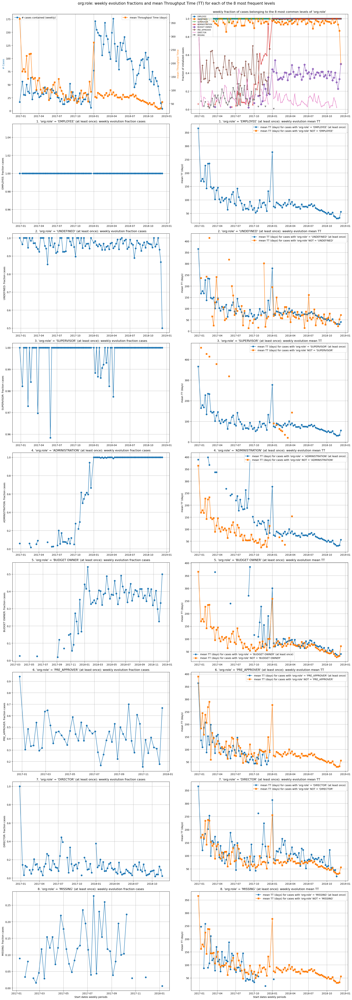

In [40]:
Inter_plots.topK_categorical_eventftr_evol(event_feature='org:role', plt_type = 'type_tt', xtr_outlier_rem = False)

#### __4.1.2 'org:role' - Representation type: Case Length (NEPC)__

Computing the weekly aggregations for each of the 8 most frequently occurring levels of categorical event feature 'org:role': 100%|██████████| 8/8 [00:00<00:00, 20.93it/s]


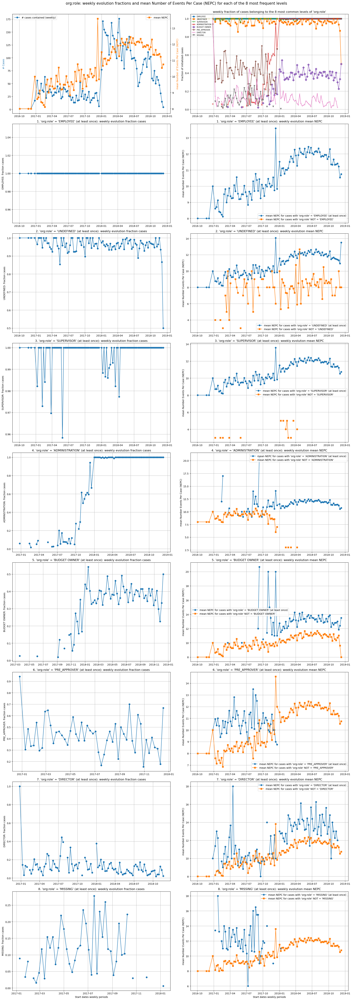

In [13]:
Inter_plots.topK_categorical_eventftr_evol(event_feature='org:role', plt_type = 'type_events_case', xtr_outlier_rem = False)

### __4.2 Categorical Event Feature: 'concept:name'__  
__'concept:name'__ refers to the column containing the __activity labels__ of each event. The BPIC20 International Declarations event log contains 34 distinct activities. In this subsection, we investigate the dynamics for the 10 most frequently occurring activities over time.

Overall, the fractions of cases pertaining to __'concept: name'__ show a correlated trend with fractions of cases pertaining to __'org:role'__. The activities conducted by resources that disappear from 2018-01 also expire simultaneously. Such patterns have been discussed previously in the subsection of __'org:role'__. Thus, we only focus on observations that merely show up in __'concept: name'__.  

1. The mean TT of cases containing __'Permit SUBMITTED by EMPLOYEE'__ shows a common fluctuation throughout the log period, while cases that do not contain this activity presents a linearly decling trend from more than 450 days towards complete disapperance in 2018-04. This pattern is interesting since most trends usually show a fluctuated instead of a linear change. However, since in this event log __'Permit SUBMITTED by EMPLOYEE'__ is used as the start activity to get a travel permit in most cases, the cases that don't contain it indicate a non-permitted travel which is gradually eliminated and totally prohibited in 2018-04. This can be identified as a gradual concept drift in data perspective.  

2. __Mean Throughput Time (TT) cases pertaining to a certain level vs. mean TT all other cases__:   
    - Mean TT of cases among each level of 'concept: name' has a common isolated peak at 2018-01, which represents a ubiquitous extension of time spent in the process for ongoing cases at this point of time.
    - Mean TT of cases containing activities __'Permit APPROVED by ADMINISTRATION'__ or __'Declarations APPROVED by ADMINISTRATION'__ experiences an intermittent decrease in 2017, and a continuous fluctuation in 2018. Both activities show a synchronous change with the dynamics of role 'ADMINISTRATION' which actually starts to emerge in 2017-11.

3. __Mean Case Length (in number of events per case, aka NEPC) cases pertaining to a certain level vs. mean NEPC all other cases__:  
    - Mean NEPC of all cases generally increases from around 10 to about 12. This rising pattern can be observed in cases pertaining to multiple activities.  
    - A single peak in 2018-01 can be observed in mean NEPC pertaining to each level. The extreme outlier of mean NEPC can be caused by the fact that ongoing cases which still don't finish in the change point need to start a new process from the begining, bringing more activities in their processes.

#### __4.2.1 'concept:name' - Representation type: Throughput Time (TT)__

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'concept:name': 100%|██████████| 10/10 [00:00<00:00, 21.96it/s]


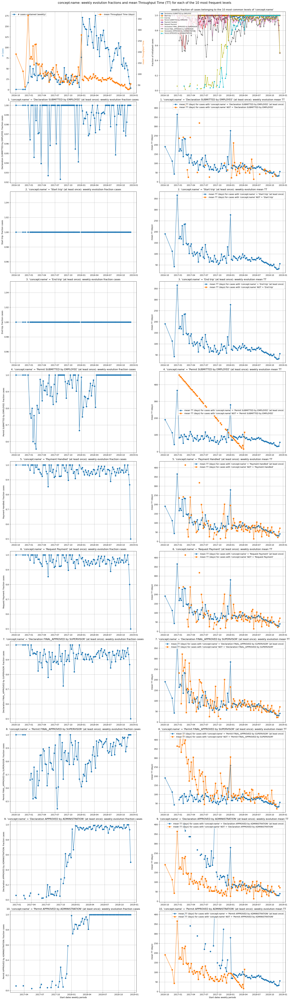

In [14]:
Inter_plots.topK_categorical_eventftr_evol(event_feature='concept:name', plt_type = 'type_tt', xtr_outlier_rem = False)

#### __4.2.2 'concept:name' - Representation type: Case Length (NEPC)__

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'concept:name': 100%|██████████| 10/10 [00:00<00:00, 21.05it/s]


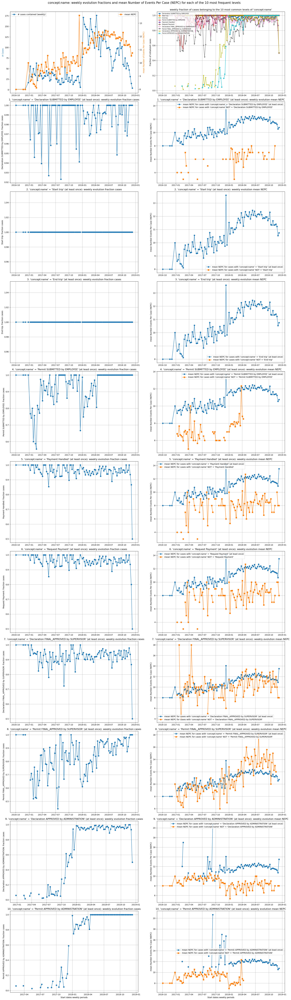

In [15]:
Inter_plots.topK_categorical_eventftr_evol(event_feature='concept:name', plt_type = 'type_events_case', xtr_outlier_rem = False)

## __5. Numerical Case Features__  
1. The BPIC20 International Declarations event log contains only 5 numerical case features, 4 out of which represent the final approved or actual travel expense and 1 represents a requested travel budget before travelling. Finally decided by the authorities, these 4 numerical case features including __'case:Amount'__, __'case:RequestedAmount'__, __'case:OriginalAmount'__ and __'case:AdjustedAmount'__ have identical values, leading to same patterns displayed in both mean TT and mean NEPC. The only different numerical case feature __'case:Permit RequestedBudget'__ represents the requested budget filled by the employee on the travel permit file.  
2. Comparing the mean values of __'case:Permit RequestedBudget'__ and __'case:AdjustedAmount'__, we can know that the travel budget requested by employee usually will not be fully approved and be partially cut off. Overall, not that many interesting trends and patterns can be observed. Therefore, we do not elaborate further on this.

### __5.1 'Numerical Case Features' - Representation type: Throughput Time (TT)__

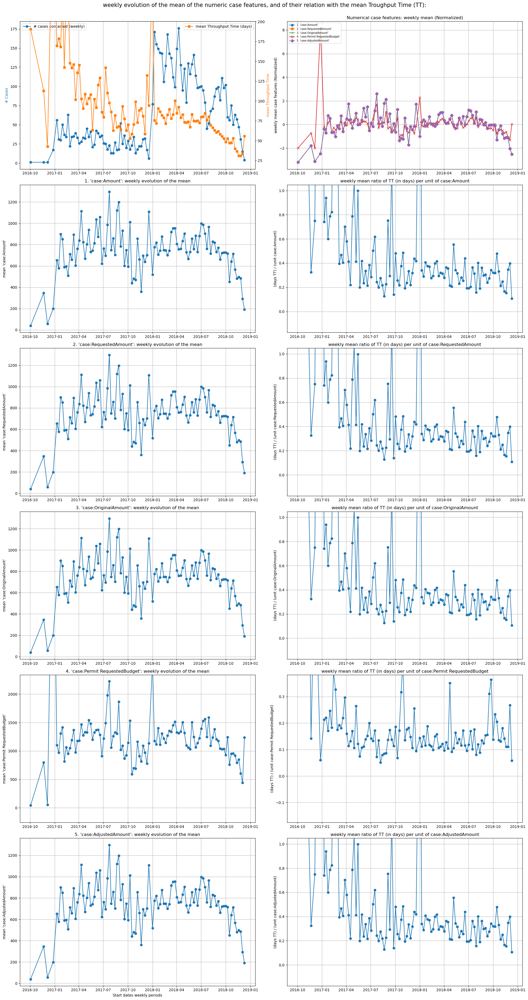

In [16]:
Inter_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures, plt_type = 'type_tt')

### __5.2 'Numerical Case Features' - Representation type: Case Length (NEPC)__

Computing the additional weekly NEPC aggregations for each of the 5 given numerical case features: 100%|██████████| 5/5 [00:00<00:00, 29.48it/s]


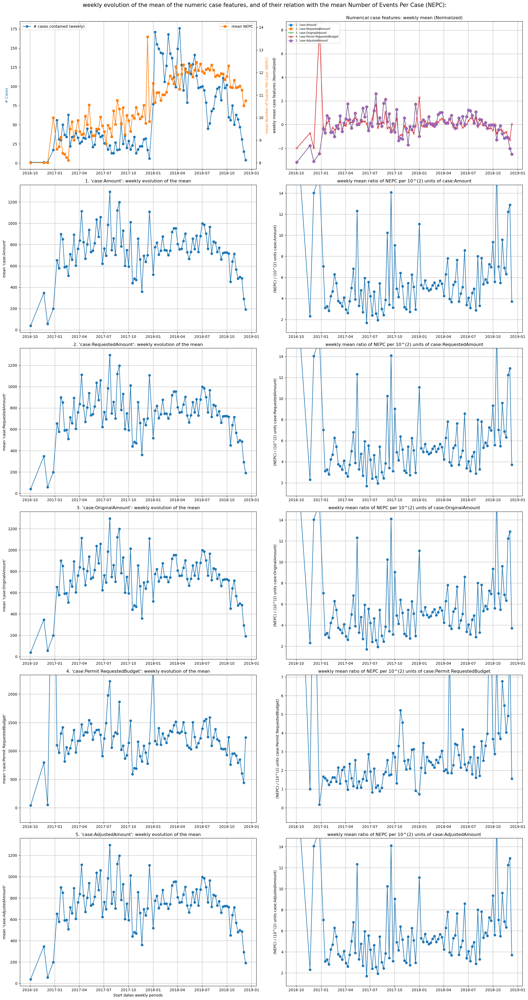

In [17]:
Inter_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures, plt_type = 'type_events_case')